In [1]:
from tqdm import tqdm_notebook as tqdm

In [2]:
import numpy as np
import pandas as pd
from glob import glob as glob

In [3]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, RobustScaler, PowerTransformer, QuantileTransformer
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.model_selection import ParameterGrid, KFold
from sklearn.linear_model import Ridge, Lasso

In [4]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
tf.__version__

'2.2.0'

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')
sns.set_context('notebook')

/anaconda3/envs/neuro/lib/python3.7/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# 1. Data Preparation

In [87]:
# Load target values and corresponding scaler
targets = pd.read_csv('datasets/targets.csv')
targets = targets.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')
feature_transform = True

import joblib
scaler_targets = joblib.load('datasets/targets_scaler.pkl')

In [88]:
# Extract ID for train and test set
train_id = targets.index.values
sample_submission = pd.read_csv('sample_submission.csv')
test_id = np.unique(sample_submission.Id.str.split('_', expand=True)[0].astype('int'))

In [89]:
# Reset scaling and transformation
temp = scaler_targets.inverse_transform(targets)
temp[:, 1:] = np.power(temp[:, 1:], 1./1.5)
df_target = pd.DataFrame(temp, columns=targets.columns)
df_target.head()

,age,domain1_var1,domain1_var2,domain2_var1,domain2_var2
0,57.436077,30.571975,62.553736,53.325130,51.427998
1,59.580851,50.969456,67.470628,60.651856,58.311361
2,71.413018,53.152498,58.012103,52.418389,62.536641
3,66.532630,NaN,NaN,52.108977,69.993075
4,38.617381,49.197021,65.674285,40.151376,34.096421


In [90]:
filenames = sorted(glob('results/results_tr*csv'))
labels = np.array([[r[19:].split('_')[0], '_'.join(r[19:].split('.')[0].split('_')[1:])[:'_'.join(r[19:].split('.')[0].split('_')[1:]).find('merge')+5]] for r in filenames])
labels

array([['baseline', 'merge'],
       ['nn-multi', 'merge'],
       ['nn-multi', 'short_merge'],
       ['nn-single', 'merge'],
       ['nn-single', 'short_merge'],
       ['ridge', 'age_merge'],
       ['ridge', 'age_short_merge'],
       ['ridge', 'merge'],
       ['ridge', 'short_merge'],
       ['sgd', 'age_merge'],
       ['sgd', 'age_short_merge'],
       ['sgd', 'merge'],
       ['sgd', 'short_merge'],
       ['svr-linear', 'age_merge'],
       ['svr-linear', 'age_short_merge'],
       ['svr-linear', 'merge'],
       ['svr-linear', 'short_merge'],
       ['svr-rbf', 'age_merge'],
       ['svr-rbf', 'age_short_merge'],
       ['svr-rbf', 'merge'],
       ['svr-rbf', 'short_merge']], dtype='<U15')

In [91]:
# Collect datasets
dataset = []
for i, f in enumerate(filenames):
    df_temp = pd.read_csv(f)
    df_temp['model'] = labels[i, 0]
    df_temp['dataset'] = labels[i, 1]
    dataset.append(df_temp)
df_data = pd.concat(dataset)

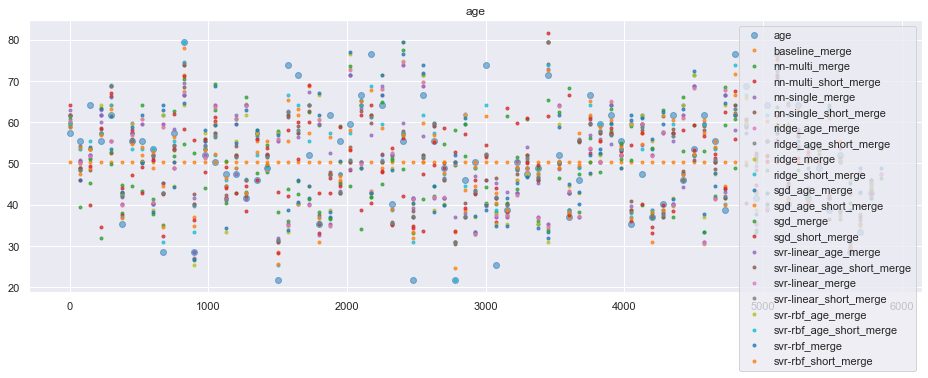

In [92]:
# Plot predictions
target_id = 'age'
step_size = 75

df_target[target_id][::step_size].plot(marker='o', lw=0, figsize=(16, 5), alpha=0.5)
for k, g in df_data.groupby(['model', 'dataset']):
    g[target_id][::step_size].plot(marker='.', lw=0, alpha=0.75, figsize=(16, 5), label='_'.join(k))
plt.legend()
plt.title(target_id);

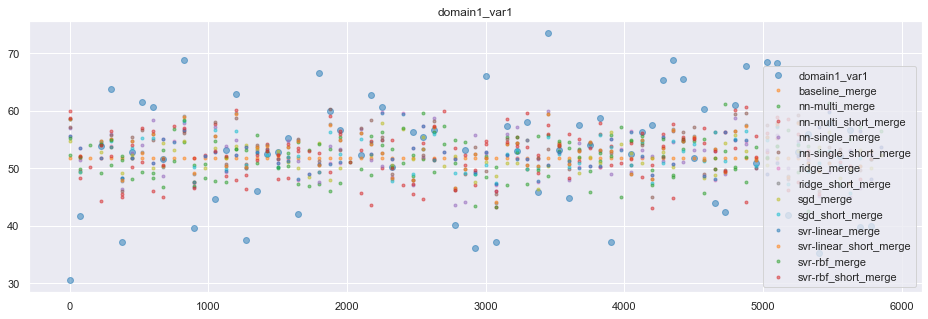

In [93]:
# Plot predictions
target_id = 'domain1_var1'
step_size = 75

df_target[target_id][::step_size].plot(marker='o', lw=0, figsize=(16, 5), alpha=0.5)
for k, g in df_data.groupby(['model', 'dataset']):
    if 'age' not in k[1]:
        g[target_id][::step_size].plot(marker='.', lw=0, alpha=0.5, figsize=(16, 5), label='_'.join(k))
plt.legend()
plt.title(target_id);

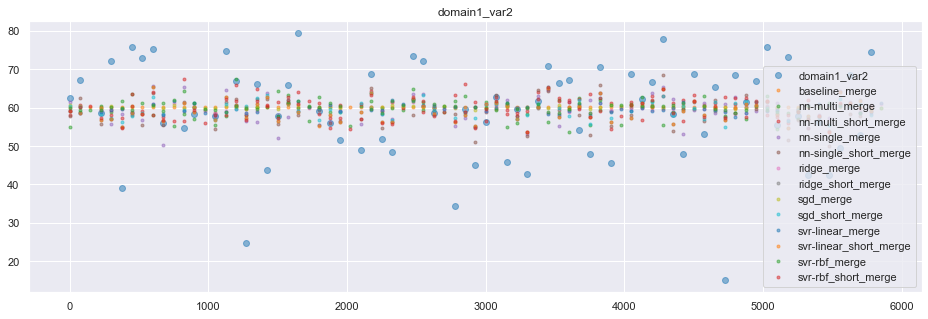

In [94]:
# Plot predictions
target_id = 'domain1_var2'
step_size = 75

df_target[target_id][::step_size].plot(marker='o', lw=0, figsize=(16, 5), alpha=0.5)
for k, g in df_data.groupby(['model', 'dataset']):
    if 'age' not in k[1]:
        g[target_id][::step_size].plot(marker='.', lw=0, alpha=0.5, figsize=(16, 5), label='_'.join(k))
plt.legend()
plt.title(target_id);

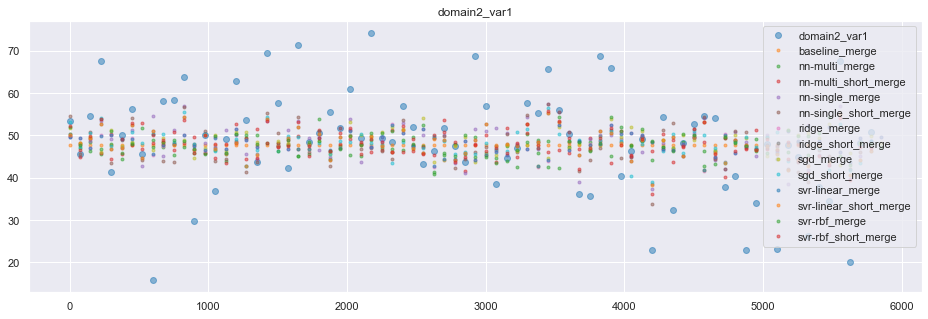

In [95]:
# Plot predictions
target_id = 'domain2_var1'
step_size = 75

df_target[target_id][::step_size].plot(marker='o', lw=0, figsize=(16, 5), alpha=0.5)
for k, g in df_data.groupby(['model', 'dataset']):
    if 'age' not in k[1]:
        g[target_id][::step_size].plot(marker='.', lw=0, alpha=0.5, figsize=(16, 5), label='_'.join(k))
plt.legend()
plt.title(target_id);

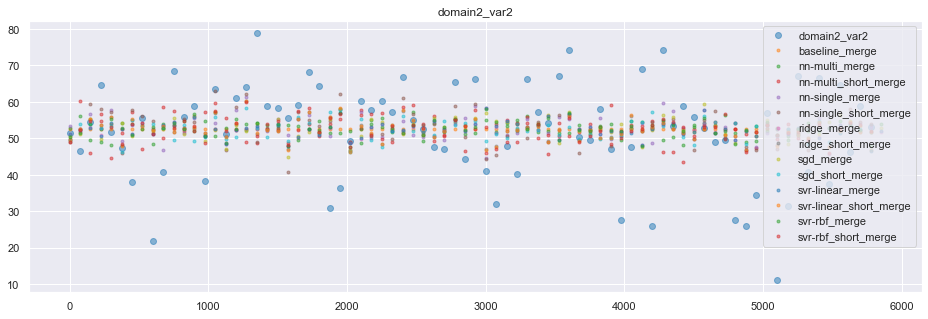

In [96]:
# Plot predictions
target_id = 'domain2_var2'
step_size = 75

df_target[target_id][::step_size].plot(marker='o', lw=0, figsize=(16, 5), alpha=0.5)
for k, g in df_data.groupby(['model', 'dataset']):
    if 'age' not in k[1]:
        g[target_id][::step_size].plot(marker='.', lw=0, alpha=0.5, figsize=(16, 5), label='_'.join(k))
plt.legend()
plt.title(target_id);

## Plot Pairplots

In [97]:
def get_dataframe(df_data, tid='age'):
    tmp = []
    names = []
    for k, g in df_data.groupby(['model', 'dataset']):
        tmp.append(g[tid].values)
        names.append(' '.join(k))
    tmp = pd.DataFrame(tmp).T
    tmp.columns = names
    return tmp

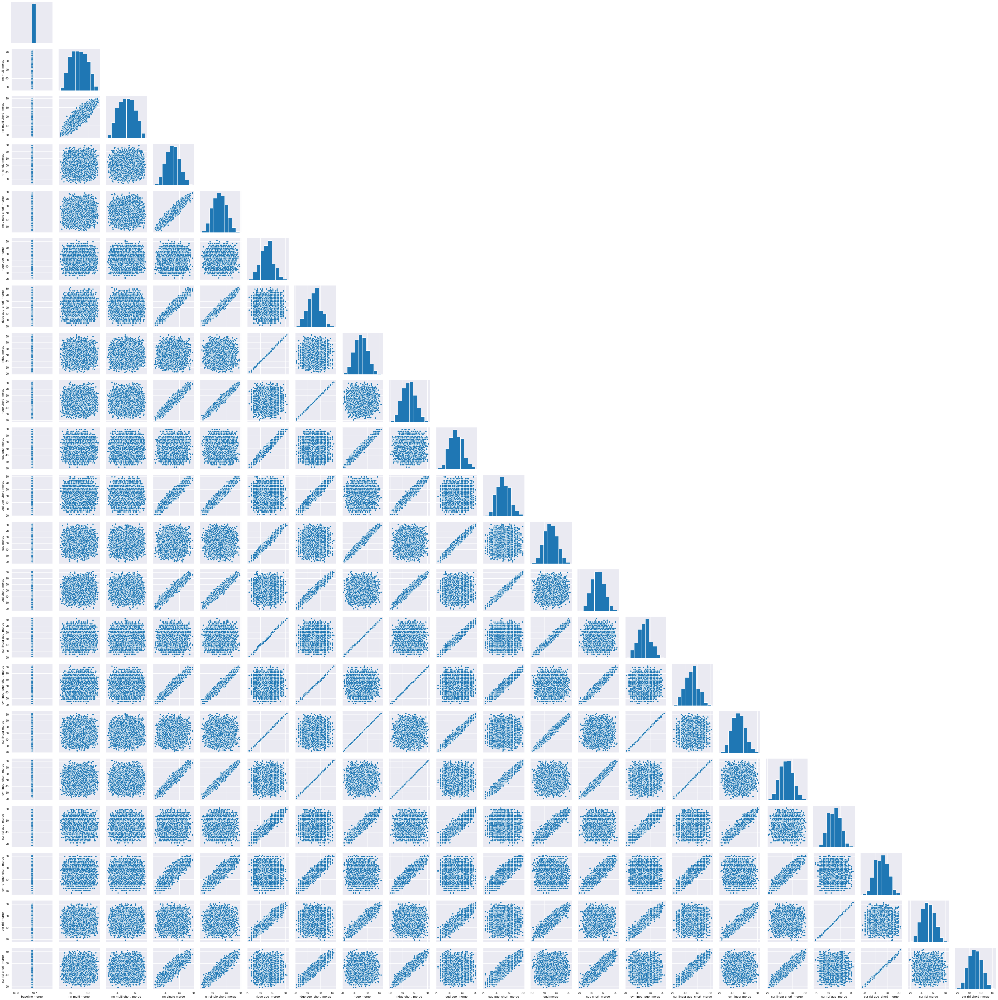

In [98]:
sns.pairplot(get_dataframe(df_data, tid='age'), corner=True)

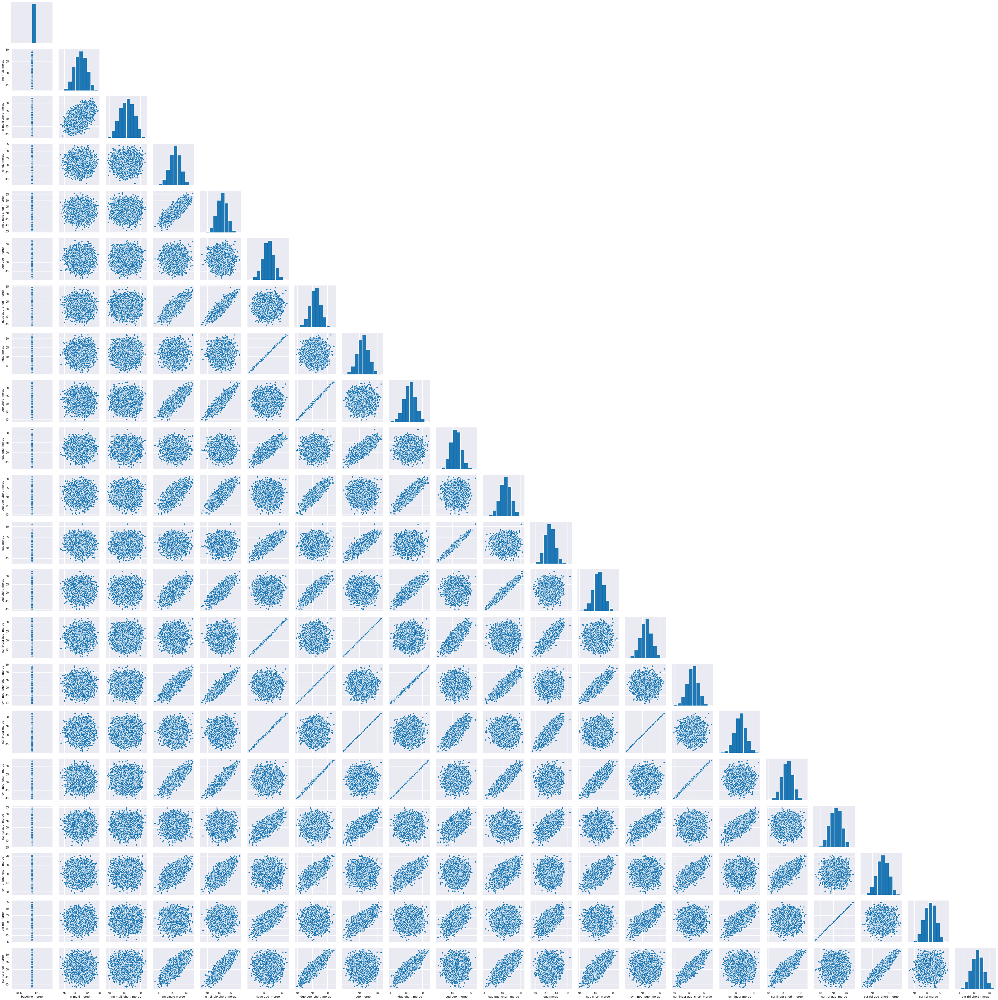

In [99]:
sns.pairplot(get_dataframe(df_data, tid='domain1_var1'), corner=True)

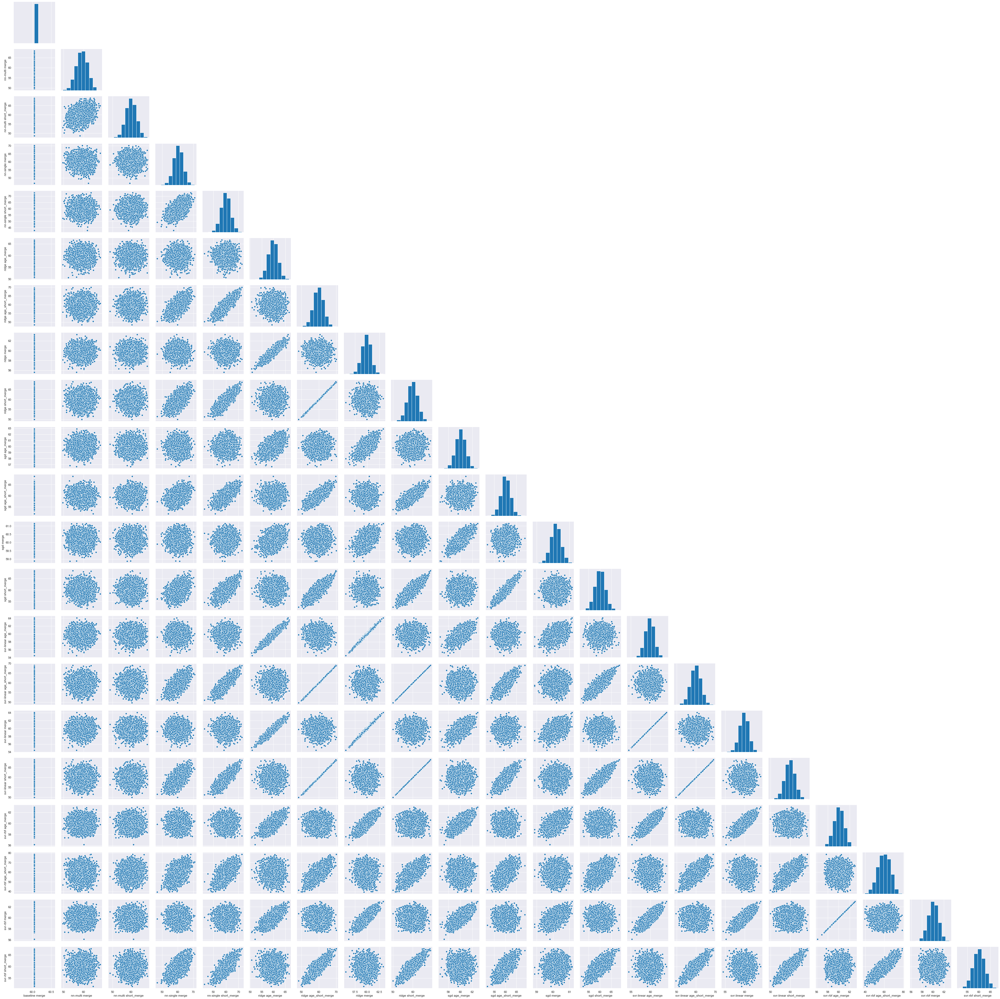

In [100]:
sns.pairplot(get_dataframe(df_data, tid='domain1_var2'), corner=True)

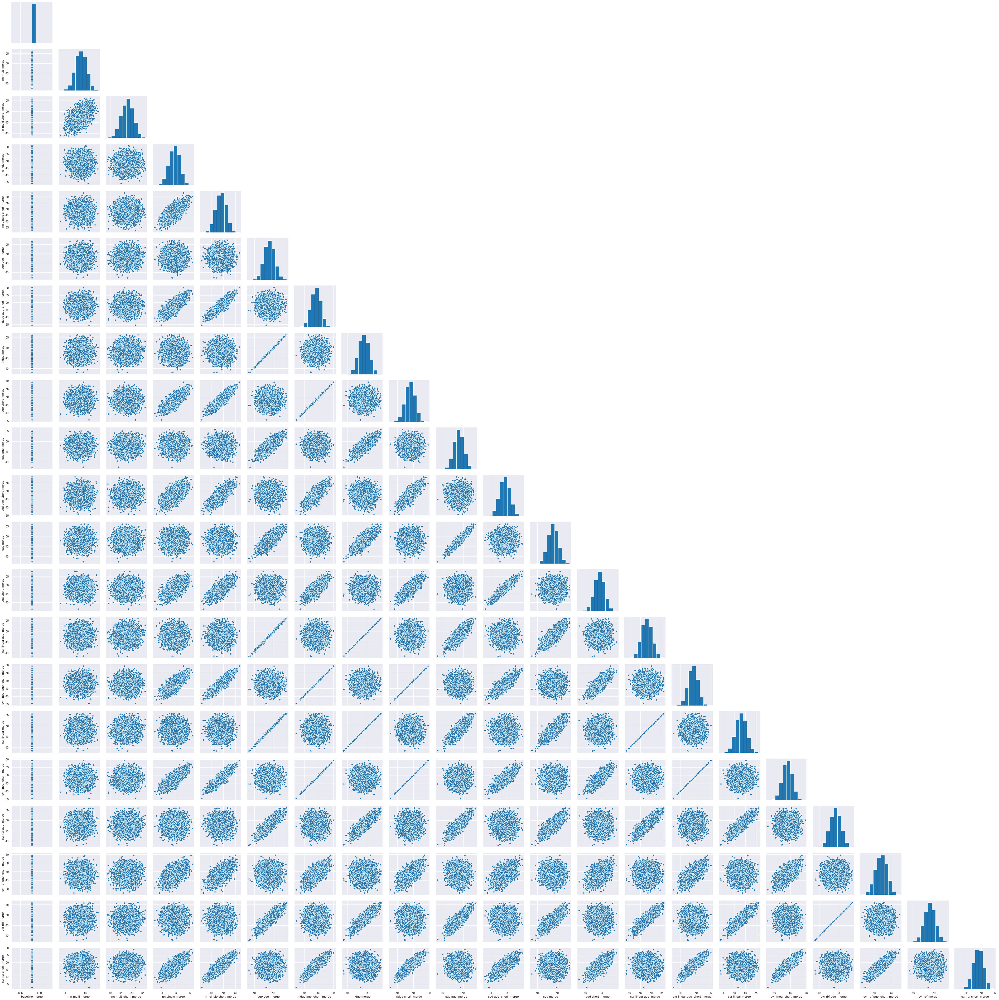

In [101]:
sns.pairplot(get_dataframe(df_data, tid='domain2_var1'), corner=True)

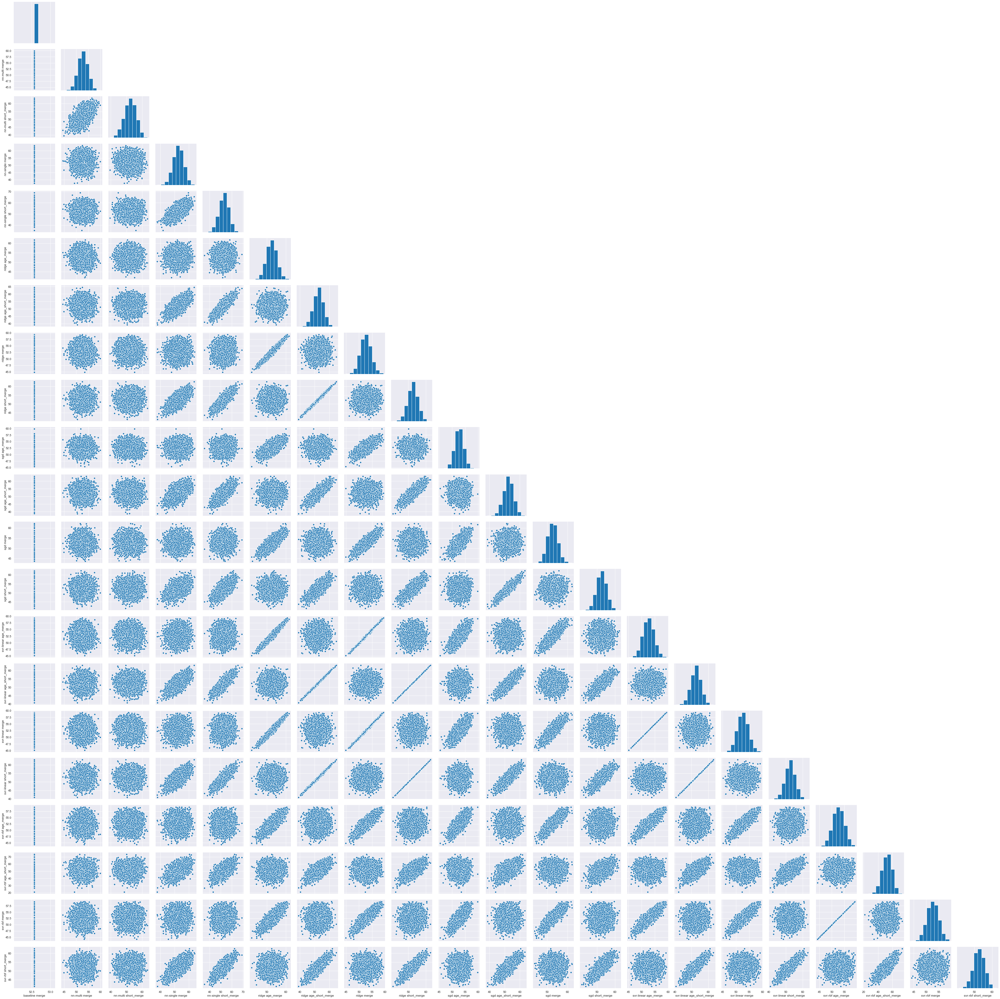

In [102]:
sns.pairplot(get_dataframe(df_data, tid='domain2_var2'), corner=True)

### Combine all predictions into one dataset

In [12]:
def get_data(tid = '_te'):
    filenames = sorted(glob('results/results%s*csv' % tid))
    labels = np.array([[r[19:].split('_')[0], '_'.join(r[19:].split('.')[0].split('_')[1:])[:'_'.join(r[19:].split('.')[0].split('_')[1:]).find('merge')+5]] for r in filenames])
    labels

    for i, f in enumerate(filenames):
        m, d = labels[i]

        df_temp = pd.read_csv(f)
        df_temp = df_temp.set_index('Id')
        df_temp.columns = ['%s_%s-%s' % (c, m, d) for c in df_temp.columns]

        if i ==0:
            df_res = df_temp.copy()
        else:
            df_res = pd.merge(df_res, df_temp, on='Id')

    return df_res.T.drop_duplicates().T

In [33]:
def load_dataset():

    # Load dataset
    X_tr = get_data(tid = '_tr')
    X_te = get_data(tid = '_te')

    # Specify target
    y = pd.read_csv('datasets/targets.csv')
    y_tr = y.rename(columns={'Unnamed: 0': 'Id'}).set_index('Id')

    # Remove missing values
    idx = y_tr.index.isin(X_tr.index)
    y_tr = y_tr[idx].values

    # Reset scaling and transformation
    y_tr = scaler_targets.inverse_transform(y_tr)
    y_tr[:, 1:] = np.power(y_tr[:, 1:], 1./1.5)

    return X_tr, X_te, y_tr, idx

In [15]:
# Create scorer function
from sklearn.metrics import make_scorer
def model_metric(y_true, y_pred):
    return np.mean(np.sum(np.abs(y_true - y_pred), axis=0) / np.sum(y_true, axis=0))

In [57]:
def create_grid(model_metric, estimator=None, cv=5, tidx=0):

    # Create Pipeline
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('pca', PCA()),
        ('estimator', estimator),
    ])

    # Define parameter grid
    alphas = np.logspace(-2, 0.5, 100)
    param_grid = [
    { 
        'scaler': [StandardScaler(),
                   RobustScaler(),
                   PowerTransformer()
                   ],
        'pca': [None],
        'estimator__tol': [1e-4],
        'estimator__alpha': alphas
    }
    ]

    # Create grid search object
    f_scorer = make_scorer(model_metric, greater_is_better=False)
    grid = GridSearchCV(pipeline,
                        cv=cv,
                        param_grid=param_grid,
                        scoring=f_scorer,
                        return_train_score=True,
                        verbose=1,
                        n_jobs=-1)

    return grid

In [58]:
def extract_predictions(X_tr, X_te, grid, target, targets, truncate_top=5):

    # Store predictions in dictionary
    res = {}
    res['tr'] = grid.predict(X_tr)
    res['te'] = grid.predict(X_te)

    """
    # Assign age to correct bin
    if target == 'age':
        age_values = np.unique(targets.age)
        for t in ['tr', 'te']:
            age_pred_tr = res['%s' % t]
            for i, a in enumerate(age_pred_tr):
                age_pred_tr[i] = age_values[np.argmin(np.abs(a-age_values))]
    """
    # Put upper and lower ceiling on predictions
    pred_order = res['te'].argsort()
    res['te'][pred_order[:truncate_top]] = res['te'][pred_order[truncate_top]]
    res['te'][pred_order[-truncate_top:]] = res['te'][pred_order[-truncate_top]]

    print("Best: %f using %s" % (grid.best_score_, grid.best_params_))
    
    return res['tr'], res['te']

In [59]:
def plot_predictions(pred_tr, pred_te, y_tr):

    # Plot prediction descrepancy on training and test set
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

    sns.regplot(x=pred_tr, y=y_tr, marker='.', ax=ax[0])
    ax[0].set_title('Prediction X_tr: %s' % target)
    ax[0].set_xlim(ax[0].get_ylim())
    
    ax[1].plot(pred_te, '.', alpha=0.5)
    ax[1].plot(pred_tr, '.', alpha=0.3)
    ax[1].set_title('Prediction X_te: %s' % target)
    plt.show()

In [60]:
def create_df_pred(grid):

    # Store grid search parameters and outcomes in dataframe
    df_pred = pd.DataFrame(grid.cv_results_)
    columns = [c for c in df_pred.columns if 'time' not in c
               and 'split' not in c
               and 'rank' not in c
               and c!='params']
    df_pred = df_pred[columns].sort_values('mean_test_score', ascending=False)
    df_pred['param_scaler'] = df_pred['param_scaler'].astype('str')
    df_pred['param_pca'] = df_pred['param_pca'].astype('str')
    df_pred['param_estimator__alpha'] = df_pred['param_estimator__alpha'].astype('float')
    
    return df_pred

In [61]:
def plot_hyperparam_fitting(df_pred):

    # Plot the model fit information
    for p in df_pred['param_pca'].unique():
        for s in df_pred['param_scaler'].unique():

            df_plot = df_pred[np.prod([df_pred['param_pca']==p,
                                       df_pred['param_scaler']==s],
                                      axis=0).astype('bool')]
            df_plot = df_plot.sort_values('param_estimator__alpha')
            
            # Skip hyperparameter combination if not explored
            if df_plot.shape[0] == 0:
                continue

            # Extract relevant modelling metrics
            train_scores = df_plot['mean_train_score']
            valid_scores = df_plot['mean_test_score']
            std_tr = df_plot['std_train_score']
            std_va = df_plot['std_test_score']

            plt.figure(figsize=(12, 4))
            alphas = df_plot['param_estimator__alpha']
            plt.semilogx(alphas, train_scores, label='Training Set')
            plt.semilogx(alphas, valid_scores, label='Validation Set')

            # Add marker and text for best score
            max_id = np.argmax(valid_scores)
            x_pos = alphas.iloc[max_id]
            y_pos = valid_scores.iloc[max_id]
            txt = '{:0.4f}'.format(y_pos)
            plt.scatter(x_pos, y_pos, marker='x', c='red', zorder=10)
            plt.text(x_pos, y_pos, txt, fontdict={'size': 18})

            # Quantify variance with ±std curves
            plt.fill_between(alphas, train_scores-std_tr, train_scores+std_tr, alpha=0.3)
            plt.fill_between(alphas, valid_scores-std_va, valid_scores+std_va, alpha=0.3)
            plt.ylabel('Performance metric')
            plt.xlabel('Model parameter')

            # Adjust x-lim, y-lim, add legend and adjust layout
            plt.legend()
            plt.title('%s\n%s' % (str(s), str(p)))
            plt.show()

In [62]:
def run_prediction(model_metric, target='age', estimator=None, tidx=0):
    
    # Extract dataset
    X_tr, X_te, y_tr, idx = load_dataset()
    y_tr = y_tr[:, tidx]
    print('Size of dataset: ', X_tr.shape)
    
    # Create grid search object
    grid = create_grid(model_metric, estimator=estimator, tidx=tidx)
    
    # Run grid search
    res = grid.fit(X_tr, y_tr)
    
    # Compute predictions
    pred_tr, pred_te = extract_predictions(X_tr, X_te, grid, target, targets)
    
    # Plot predictions
    plot_predictions(pred_tr, pred_te, y_tr)
    
    # Create prediction dataframe
    df_pred = create_df_pred(grid)
    
    # Plot prediction behaviour
    plot_hyperparam_fitting(df_pred)
    
    return df_pred, pred_tr, pred_te, grid, idx

In [63]:
def display_grid_optimization_details(grid):
    df_cv = pd.DataFrame(grid.cv_results_)
    selecter = df_cv.columns.str.contains('param_') + \
               df_cv.columns.str.contains('mean') + \
               df_cv.columns.str.contains('std')
    df_cv = df_cv.loc[:, selecter]
    df_cv = df_cv.loc[:, ~df_cv.columns.str.contains('_time')]
    display(df_cv.sort_values('mean_test_score', ascending=False)[:10])

In [64]:
def create_results_dataframe(predictions, targets, t_idx, res_type='_te'):

    # Collect results
    t_keys = [k for k in predictions.keys() if res_type in k]
    results = np.transpose([predictions[k] for k in t_keys])

    # Store results in Dataframe
    df_results = pd.DataFrame(results, columns=targets.columns)

    """
    # Assign age to correct bin
    age_values = np.unique(scaler_targets.inverse_transform(targets)[:, 0])
    for i, a in enumerate(df_results.age):
        df_results.age[i] = age_values[np.argmin(np.abs(a-age_values))]
    """

    # Add ID back to test results
    if res_type=='_tr':
        df_results.insert(0, 'Id', t_idx[predictions['age_miss']])
        df_results.set_index('Id', inplace=True)
    elif res_type=='_te':
        df_results.insert(0, 'Id', t_idx)
        df_results.set_index('Id', inplace=True)
    
    return df_results

In [65]:
def grids_summary(grids):

    grid_content = []
    for g in grids:

        column_name = []
        temp = []
        for k in g.best_params_:
            column_name.append(k)
            temp.append(g.best_params_[k])
        column_name.insert(0, 'score')
        temp.insert(0, -np.round(g.best_score_, 6))
        grid_content.append(temp)


    df_grid = pd.DataFrame(grid_content, columns=column_name)
    display(df_grid)

In [66]:
def save_results(predictions, targets, train_id, test_id, sample_submission, dataset_id, score_postfix):
    
    # Get results dataframe
    df_results_tr = create_results_dataframe(predictions, targets, train_id, res_type='_tr')
    df_results_te = create_results_dataframe(predictions, targets, test_id, res_type='_te')
    
    # Store test results in CSV file
    score_postfix = '_'.join(np.array(score_postfix).astype('str'))
    submission = sample_submission.copy()
    submission['Predicted'] = np.ravel(df_results_te)
    submission.to_csv('results/h_submission_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    
    # Store dataframes in CSV files
    df_results_tr.to_csv('results/h_results_tr_%s_%s.csv' % (dataset_id, score_postfix), index=False)
    df_results_te.to_csv('results/h_results_te_%s_%s.csv' % (dataset_id, score_postfix), index=False)

    return df_results_tr, df_results_te

In [67]:
def plot_prediction_distributions(targets, df_results_tr, df_results_te):
    
    # Recreate original target dataset
    df_results = pd.DataFrame(targets, columns=targets.columns)

    # Compare target distributions of train and test set
    for c in df_results.columns:
        plt.figure(figsize=(5, 5))
        plt.title(c)
        plt.hist(df_results[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_te[c], bins=25, alpha=0.5, density=True)
        plt.hist(df_results_tr[c], bins=25, alpha=0.5, density=True)
        plt.legend(['orig', 'test', 'train'])
        plt.show()

Starting with target: age
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   15.8s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   31.2s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   50.6s
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.5min finished


Best: -0.041775 using {'estimator__alpha': 0.13688745095370805, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


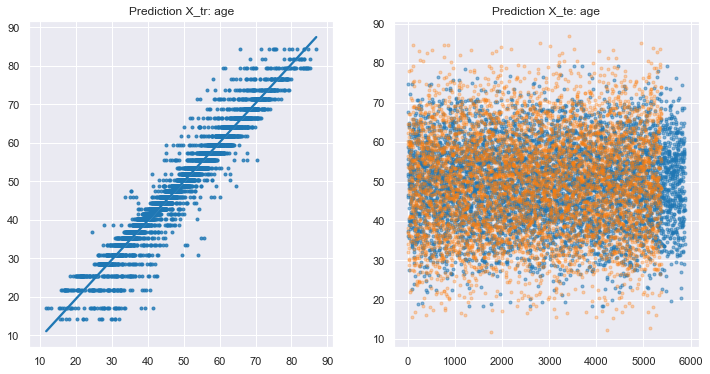

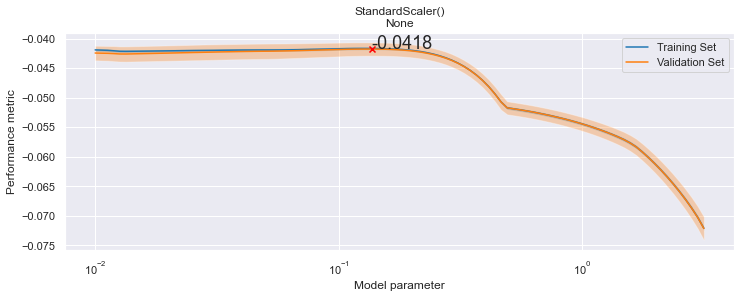

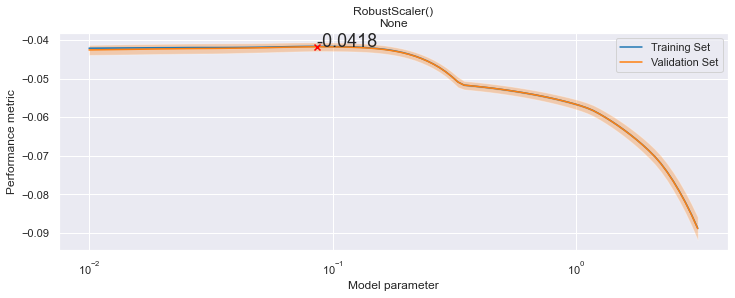

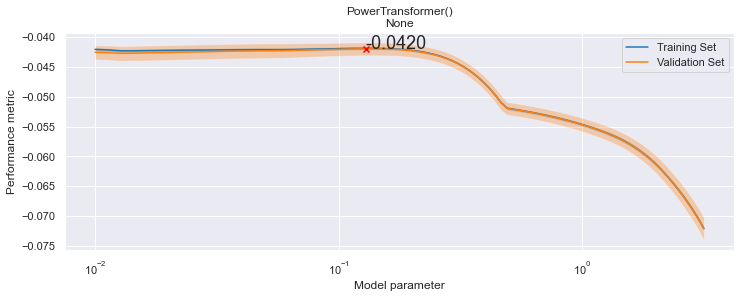

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
135,0.136887,0.0001,None,StandardScaler(),-0.041775,0.001119,-0.041675,0.000236
132,0.129155,0.0001,None,StandardScaler(),-0.041776,0.001122,-0.041671,0.000245
129,0.121859,0.0001,None,StandardScaler(),-0.041782,0.001127,-0.041671,0.000252
138,0.145083,0.0001,None,StandardScaler(),-0.041784,0.001116,-0.041687,0.000227
112,0.0859693,0.0001,None,RobustScaler(),-0.041787,0.001125,-0.041672,0.000243
115,0.0911163,0.0001,None,RobustScaler(),-0.041789,0.001118,-0.041678,0.000238
126,0.114976,0.0001,None,StandardScaler(),-0.041793,0.001134,-0.041677,0.000256
109,0.0811131,0.0001,None,RobustScaler(),-0.041794,0.001132,-0.041676,0.000248
118,0.0965714,0.0001,None,RobustScaler(),-0.041797,0.001116,-0.041687,0.000228
141,0.153769,0.0001,None,StandardScaler(),-0.041802,0.001109,-0.041707,0.000222


Starting with target: domain1_var1
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   20.8s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   38.3s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   57.3s
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.6min finished


Best: -0.052235 using {'estimator__alpha': 0.1291549665014884, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


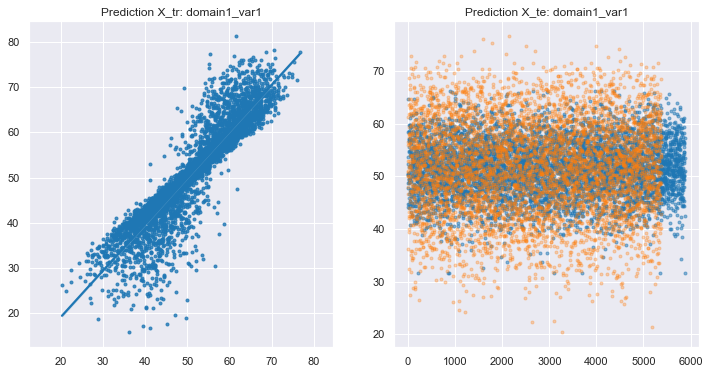

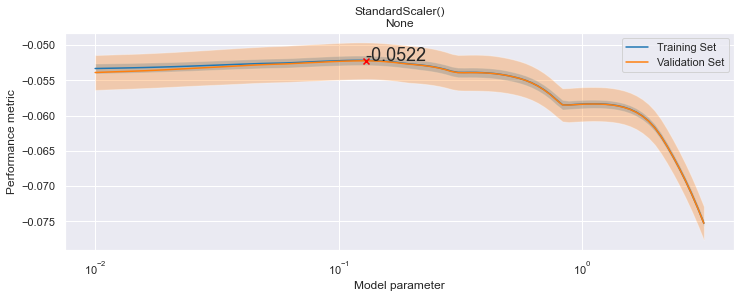

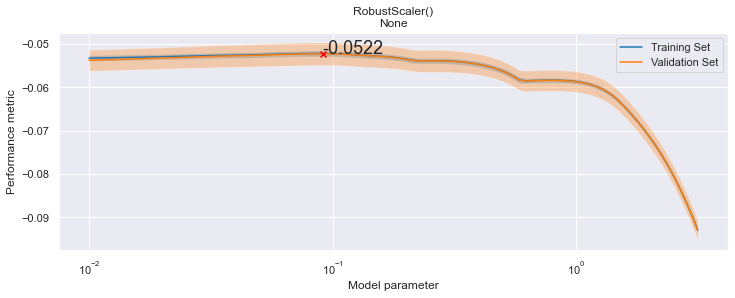

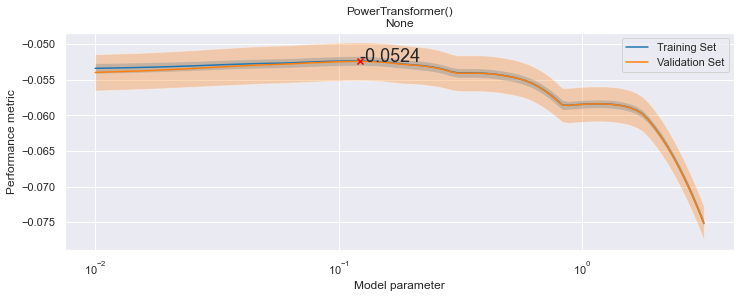

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
132,0.129155,0.0001,None,StandardScaler(),-0.052235,0.002605,-0.052169,0.000679
129,0.121859,0.0001,None,StandardScaler(),-0.052238,0.002612,-0.052165,0.000679
115,0.0911163,0.0001,None,RobustScaler(),-0.052241,0.002617,-0.052175,0.000678
112,0.0859693,0.0001,None,RobustScaler(),-0.052244,0.002624,-0.052170,0.000679
135,0.136887,0.0001,None,StandardScaler(),-0.052246,0.002601,-0.052186,0.000675
126,0.114976,0.0001,None,StandardScaler(),-0.052250,0.002617,-0.052170,0.000678
118,0.0965714,0.0001,None,RobustScaler(),-0.052250,0.002615,-0.052191,0.000673
109,0.0811131,0.0001,None,RobustScaler(),-0.052257,0.002628,-0.052176,0.000678
123,0.108481,0.0001,None,StandardScaler(),-0.052272,0.002616,-0.052184,0.000677
121,0.102353,0.0001,None,RobustScaler(),-0.052276,0.002611,-0.052219,0.000668


Starting with target: domain1_var2
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:   15.1s
[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:   29.6s
[Parallel(n_jobs=-1)]: Done 816 tasks      | elapsed:   47.3s
[Parallel(n_jobs=-1)]: Done 1266 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.4min finished


Best: -0.055767 using {'estimator__alpha': 0.18307382802953678, 'estimator__tol': 0.0001, 'pca': None, 'scaler': RobustScaler()}


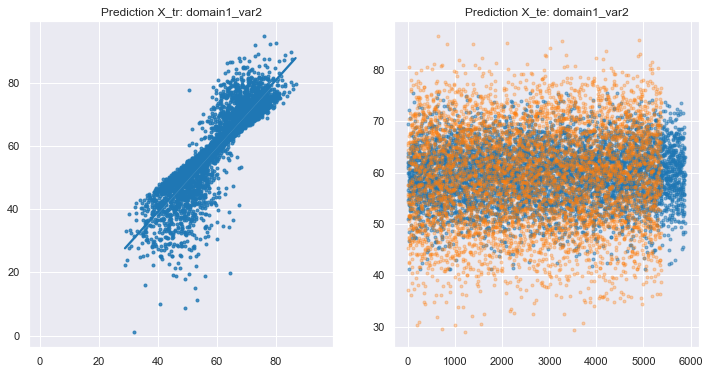

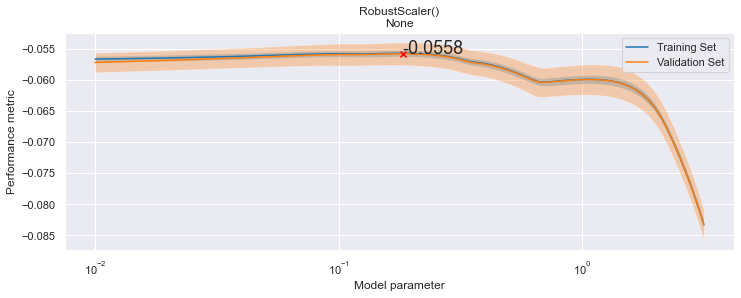

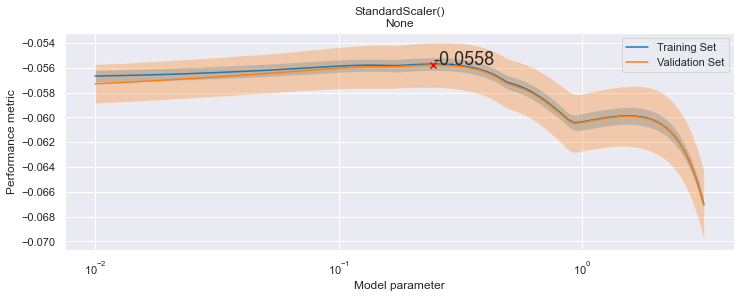

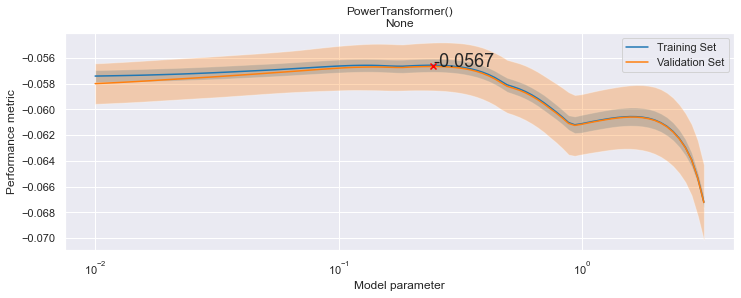

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
151,0.183074,0.0001,None,RobustScaler(),-0.055767,0.001829,-0.055684,0.000533
148,0.172732,0.0001,None,RobustScaler(),-0.055768,0.001816,-0.055683,0.000531
145,0.162975,0.0001,None,RobustScaler(),-0.055777,0.001803,-0.055694,0.000530
154,0.194034,0.0001,None,RobustScaler(),-0.055778,0.001845,-0.055695,0.000535
165,0.244844,0.0001,None,StandardScaler(),-0.055785,0.001818,-0.055696,0.000532
168,0.259502,0.0001,None,StandardScaler(),-0.055788,0.001832,-0.055700,0.000533
162,0.231013,0.0001,None,StandardScaler(),-0.055791,0.001805,-0.055704,0.000531
142,0.153769,0.0001,None,RobustScaler(),-0.055795,0.001792,-0.055713,0.000529
157,0.205651,0.0001,None,RobustScaler(),-0.055802,0.001861,-0.055717,0.000536
171,0.275039,0.0001,None,StandardScaler(),-0.055804,0.001847,-0.055715,0.000534


Starting with target: domain2_var1
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    4.5s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   19.0s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   37.8s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   56.6s
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.5min finished


Best: -0.066142 using {'estimator__alpha': 0.21796353277791214, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


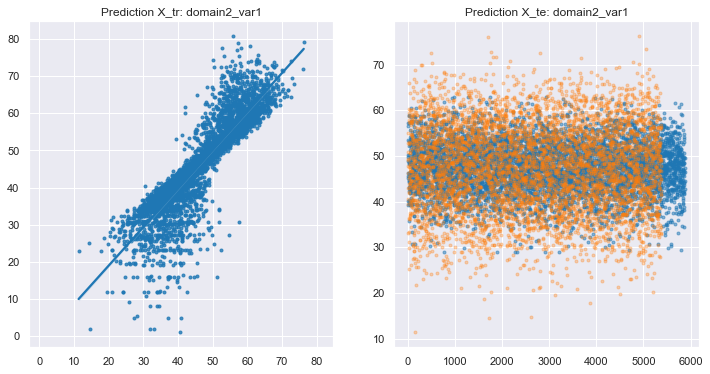

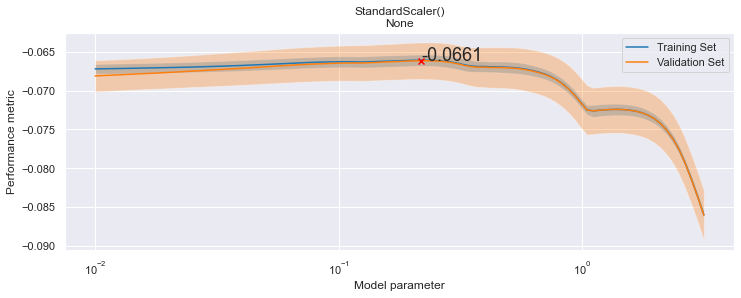

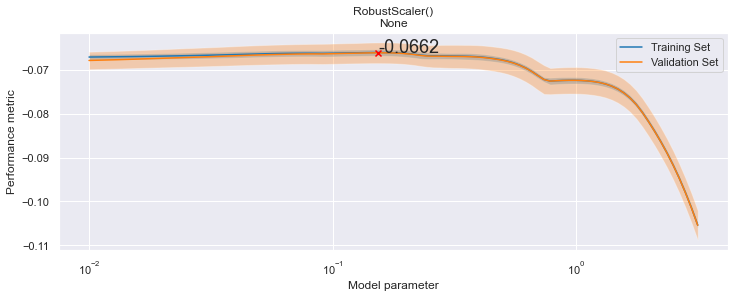

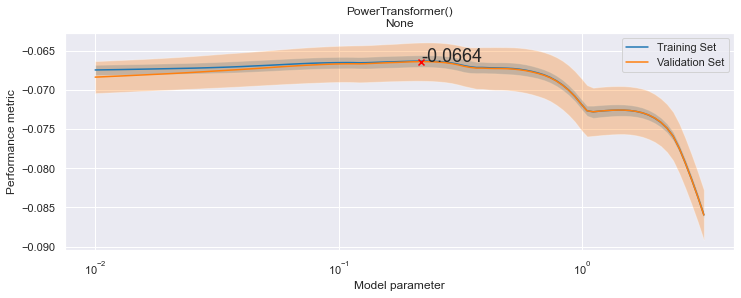

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
159,0.217964,0.0001,None,StandardScaler(),-0.066142,0.002356,-0.066068,0.000729
162,0.231013,0.0001,None,StandardScaler(),-0.066144,0.002366,-0.066073,0.000733
156,0.205651,0.0001,None,StandardScaler(),-0.066152,0.002347,-0.066079,0.000726
142,0.153769,0.0001,None,RobustScaler(),-0.066153,0.002355,-0.066081,0.000736
145,0.162975,0.0001,None,RobustScaler(),-0.066155,0.002364,-0.066087,0.000740
165,0.244844,0.0001,None,StandardScaler(),-0.066156,0.002378,-0.066092,0.000734
139,0.145083,0.0001,None,RobustScaler(),-0.066162,0.002347,-0.066091,0.000731
148,0.172732,0.0001,None,RobustScaler(),-0.066169,0.002371,-0.066109,0.000746
153,0.194034,0.0001,None,StandardScaler(),-0.066174,0.002339,-0.066099,0.000724
136,0.136887,0.0001,None,RobustScaler(),-0.066186,0.002336,-0.066111,0.000730


Starting with target: domain2_var2
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:   17.1s
[Parallel(n_jobs=-1)]: Done 466 tasks      | elapsed:   31.9s
[Parallel(n_jobs=-1)]: Done 816 tasks      | elapsed:   50.2s
[Parallel(n_jobs=-1)]: Done 1266 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.4min finished


Best: -0.064961 using {'estimator__alpha': 0.2750387840931946, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


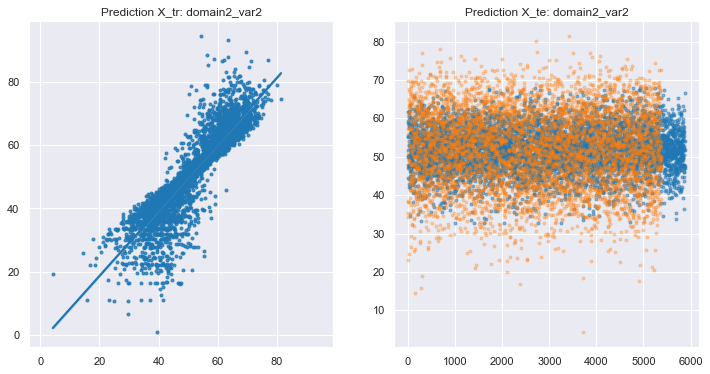

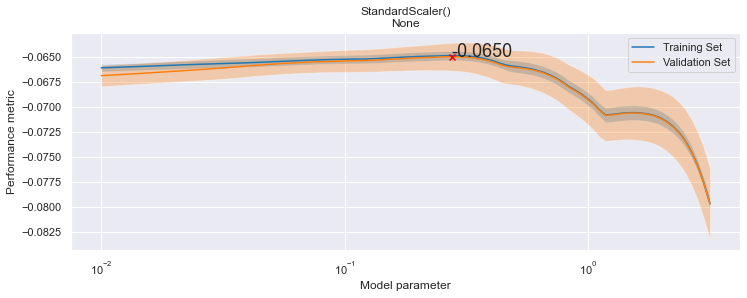

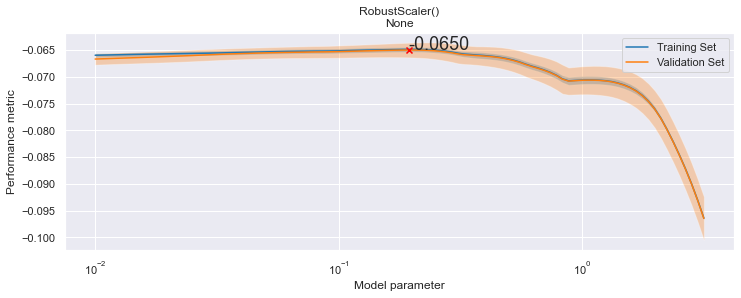

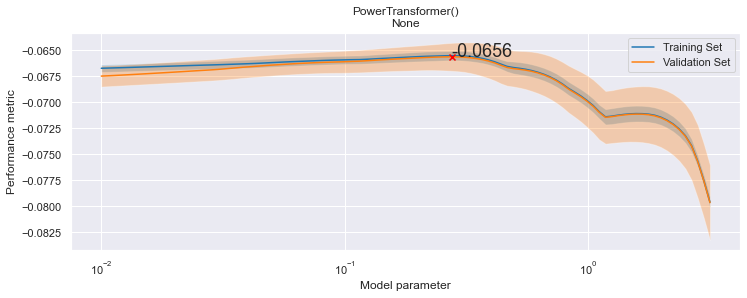

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
171,0.275039,0.0001,None,StandardScaler(),-0.064961,0.001388,-0.064842,0.000454
168,0.259502,0.0001,None,StandardScaler(),-0.064965,0.001356,-0.064850,0.000452
174,0.291505,0.0001,None,StandardScaler(),-0.064966,0.001424,-0.064846,0.000457
154,0.194034,0.0001,None,RobustScaler(),-0.064978,0.001364,-0.064854,0.000455
157,0.205651,0.0001,None,RobustScaler(),-0.064979,0.001400,-0.064854,0.000458
165,0.244844,0.0001,None,StandardScaler(),-0.064980,0.001328,-0.064869,0.000450
177,0.308958,0.0001,None,StandardScaler(),-0.064984,0.001461,-0.064864,0.000461
151,0.183074,0.0001,None,RobustScaler(),-0.064984,0.001333,-0.064865,0.000453
160,0.217964,0.0001,None,RobustScaler(),-0.064992,0.001437,-0.064866,0.000461
148,0.172732,0.0001,None,RobustScaler(),-0.065002,0.001306,-0.064885,0.000451


,score,estimator__alpha,estimator__tol,pca,scaler
0,0.041775,0.136887,0.0001,None,StandardScaler()
1,0.052235,0.129155,0.0001,None,StandardScaler()
2,0.055767,0.183074,0.0001,None,RobustScaler()
3,0.066142,0.217964,0.0001,None,StandardScaler()
4,0.064961,0.275039,0.0001,None,StandardScaler()


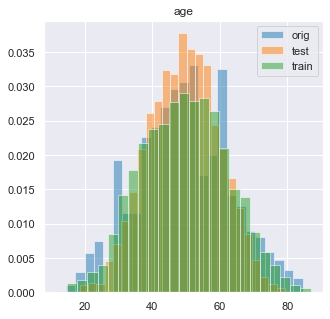

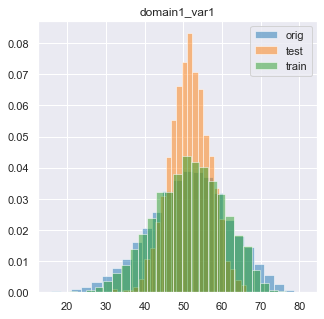

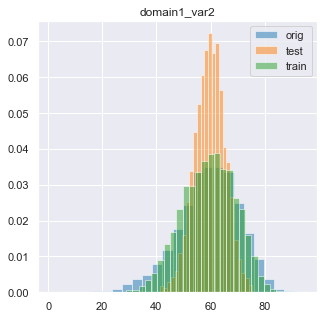

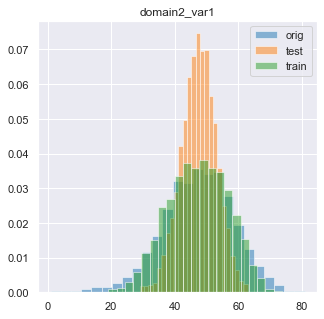

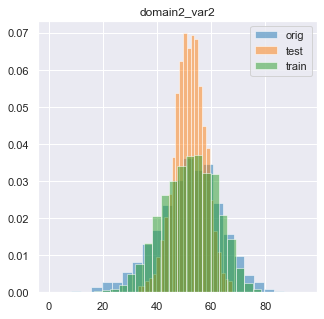

Score: 0.0544 | -0.0418 -0.0522 -0.0558 -0.0661 -0.0650


In [68]:
dataset_id = 'lasso'

predictions = {}
scores = []
grids = []

for tidx, target in enumerate(['age', 'domain1_var1', 'domain1_var2', 'domain2_var1', 'domain2_var2']):

    print('Starting with target: %s' % (target))
    estimator = Lasso()
    df_pred, pred_tr, pred_te, grid, idx = run_prediction(
        model_metric, target=target, estimator=estimator, tidx=tidx)

    display_grid_optimization_details(grid)

    predictions['%s_tr' % target] = pred_tr
    predictions['%s_te' % target] = pred_te
    predictions['%s_miss' % target] = idx

    scores.append(grid.best_score_)
    grids.append(grid)

# Display grids summary
grids_summary(grids)

# Compute overall score
weights = [.3, .175, .175, .175, .175]
score = np.sum([-s * weights[i] for i, s in enumerate(scores)])
score_postfix = [int(score*10000)] + [-int(s*10000) for i, s in enumerate(scores)]

df_results_tr, df_results_te = save_results(
    predictions, targets, train_id, test_id, sample_submission, dataset_id, score_postfix)

_, _, y_tr, _ = load_dataset()
df_target = pd.DataFrame(y_tr, columns=targets.columns)
plot_prediction_distributions(df_target, df_results_tr, df_results_te)

# Feedback of overall score
txt = 'Score: {:.4f} | {:.4f} {:.4f} {:.4f} {:.4f} {:.4f}'.format(score, *scores)
print(txt)

In [85]:
def create_grid(model_metric, estimator=None, cv=5, tidx=0):

    # Create Pipeline
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('pca', PCA()),
        ('estimator', estimator),
    ])

    # Define parameter grid
    alphas = np.logspace(-2, 3, 100)
    param_grid = [
    { 
        'scaler': [StandardScaler(),
                   RobustScaler(),
                   PowerTransformer()
                   ],
        'pca': [None],
        'estimator__tol': [1e-4],
        'estimator__alpha': alphas
    }
    ]

    # Create grid search object
    f_scorer = make_scorer(model_metric, greater_is_better=False)
    grid = GridSearchCV(pipeline,
                        cv=cv,
                        param_grid=param_grid,
                        scoring=f_scorer,
                        return_train_score=True,
                        verbose=1,
                        n_jobs=-1)

    return grid

Starting with target: age
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   23.4s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   43.5s
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.4min finished


Best: -0.042310 using {'estimator__alpha': 0.09111627561154892, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


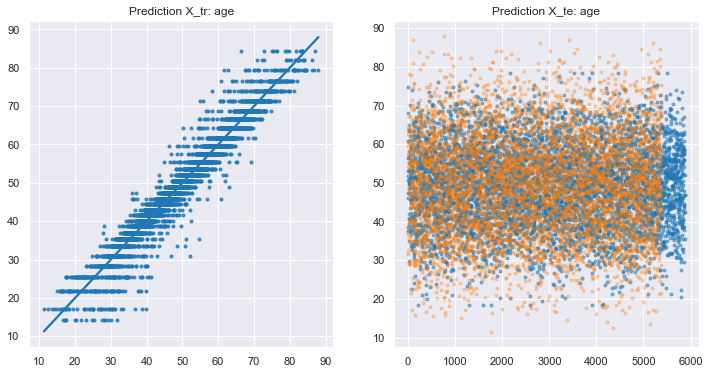

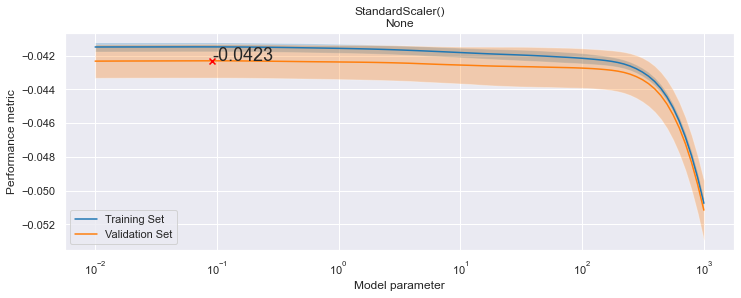

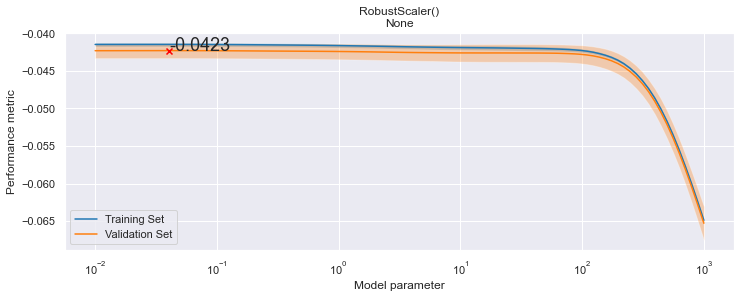

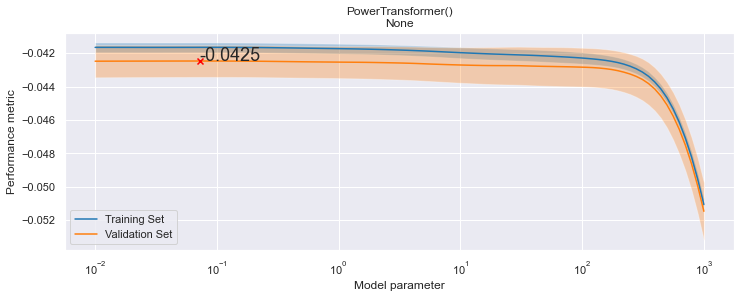

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
57,0.0911163,0.0001,None,StandardScaler(),-0.042310,0.000997,-0.041486,0.000263
54,0.0811131,0.0001,None,StandardScaler(),-0.042310,0.000997,-0.041486,0.000263
60,0.102353,0.0001,None,StandardScaler(),-0.042310,0.000997,-0.041487,0.000263
51,0.0722081,0.0001,None,StandardScaler(),-0.042310,0.000996,-0.041485,0.000264
63,0.114976,0.0001,None,StandardScaler(),-0.042311,0.000997,-0.041488,0.000263
48,0.0642807,0.0001,None,StandardScaler(),-0.042312,0.000995,-0.041485,0.000264
37,0.0403702,0.0001,None,RobustScaler(),-0.042312,0.000997,-0.041486,0.000264
40,0.0453488,0.0001,None,RobustScaler(),-0.042312,0.000996,-0.041487,0.000264
34,0.0359381,0.0001,None,RobustScaler(),-0.042312,0.000996,-0.041486,0.000264
43,0.0509414,0.0001,None,RobustScaler(),-0.042312,0.000996,-0.041488,0.000263


Starting with target: domain1_var1
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  52 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:   14.3s
[Parallel(n_jobs=-1)]: Done 482 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 832 tasks      | elapsed:   48.2s
[Parallel(n_jobs=-1)]: Done 1282 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.4min finished


Best: -0.053398 using {'estimator__alpha': 30.538555088334157, 'estimator__tol': 0.0001, 'pca': None, 'scaler': RobustScaler()}


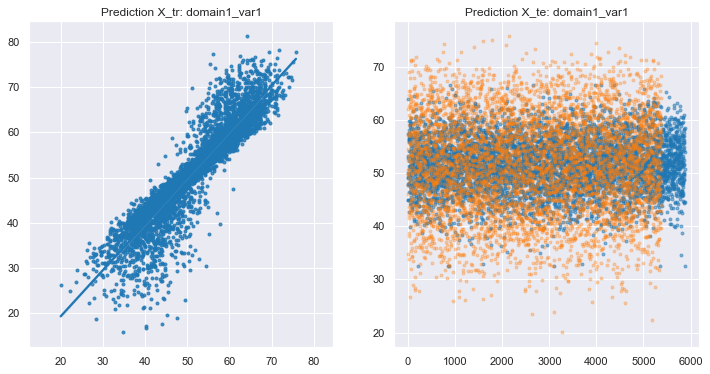

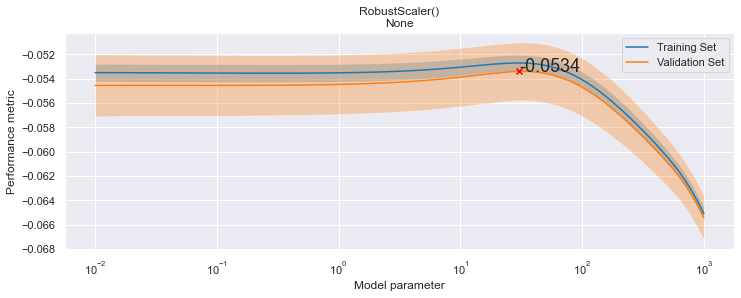

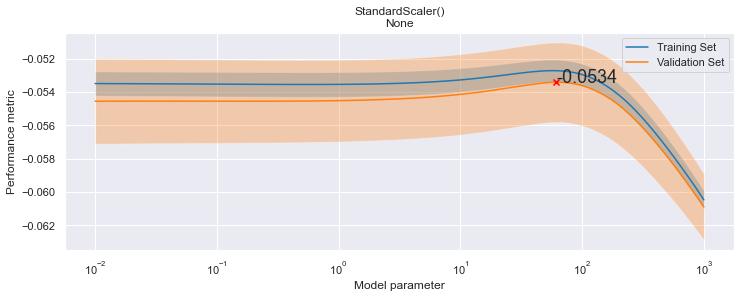

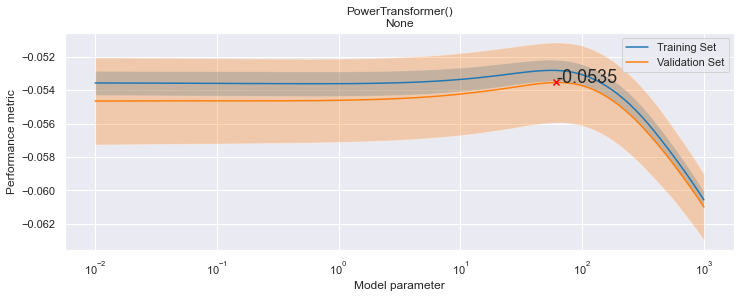

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
208,30.5386,0.0001,None,RobustScaler(),-0.053398,0.002379,-0.052705,0.000664
211,34.3047,0.0001,None,RobustScaler(),-0.053399,0.002379,-0.052716,0.000661
225,61.3591,0.0001,None,StandardScaler(),-0.053415,0.002386,-0.052721,0.000663
205,27.1859,0.0001,None,RobustScaler(),-0.053418,0.002380,-0.052711,0.000666
214,38.5353,0.0001,None,RobustScaler(),-0.053422,0.002384,-0.052747,0.000660
228,68.9261,0.0001,None,StandardScaler(),-0.053422,0.002387,-0.052740,0.000660
222,54.6228,0.0001,None,StandardScaler(),-0.053426,0.002387,-0.052721,0.000666
202,24.2013,0.0001,None,RobustScaler(),-0.053454,0.002381,-0.052731,0.000667
231,77.4264,0.0001,None,StandardScaler(),-0.053455,0.002394,-0.052779,0.000658
219,48.626,0.0001,None,StandardScaler(),-0.053455,0.002388,-0.052734,0.000667


Starting with target: domain1_var2
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  60 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   15.5s
[Parallel(n_jobs=-1)]: Done 546 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 896 tasks      | elapsed:   47.2s
[Parallel(n_jobs=-1)]: Done 1346 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.3min finished


Best: -0.055883 using {'estimator__alpha': 220.51307399030455, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


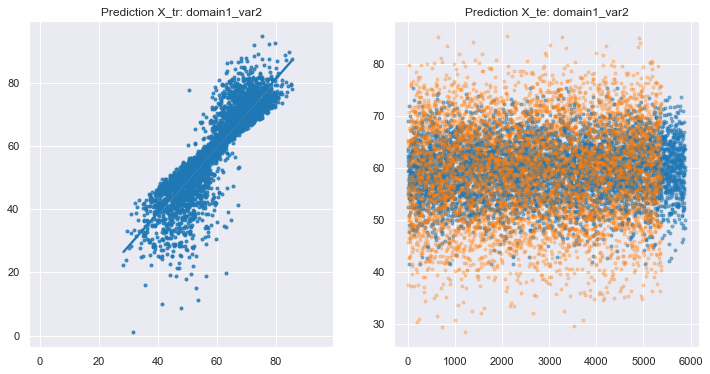

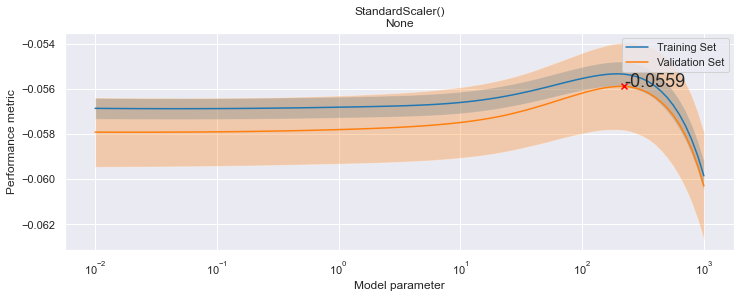

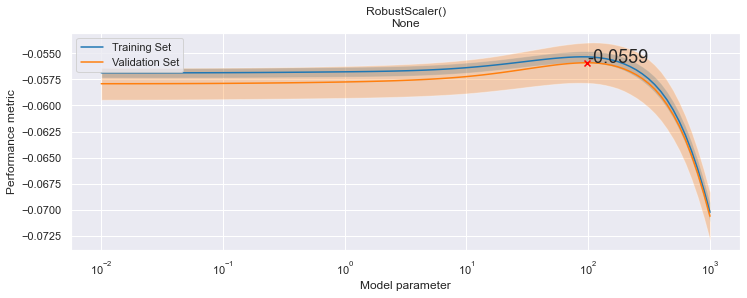

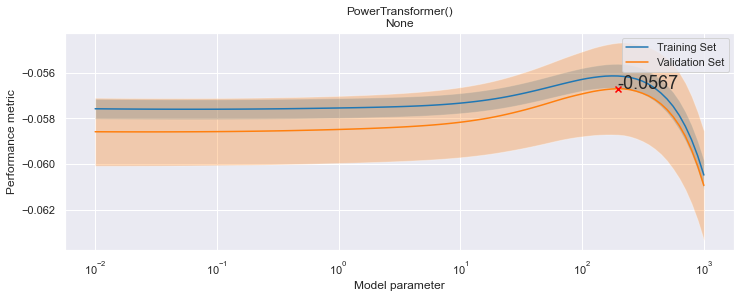

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
258,220.513,0.0001,None,StandardScaler(),-0.055883,0.001945,-0.055339,0.000554
255,196.304,0.0001,None,StandardScaler(),-0.055887,0.001920,-0.055326,0.000547
238,97.701,0.0001,None,RobustScaler(),-0.055904,0.001927,-0.055341,0.000552
252,174.753,0.0001,None,StandardScaler(),-0.055908,0.001897,-0.055334,0.000539
261,247.708,0.0001,None,StandardScaler(),-0.055908,0.001976,-0.055379,0.000562
241,109.75,0.0001,None,RobustScaler(),-0.055914,0.001954,-0.055370,0.000562
235,86.9749,0.0001,None,RobustScaler(),-0.055916,0.001906,-0.055338,0.000541
232,77.4264,0.0001,None,RobustScaler(),-0.055943,0.001883,-0.055352,0.000533
249,155.568,0.0001,None,StandardScaler(),-0.055943,0.001872,-0.055356,0.000533
244,123.285,0.0001,None,RobustScaler(),-0.055956,0.001982,-0.055427,0.000574


Starting with target: domain2_var1
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  60 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   14.5s
[Parallel(n_jobs=-1)]: Done 546 tasks      | elapsed:   27.1s
[Parallel(n_jobs=-1)]: Done 896 tasks      | elapsed:   44.9s
[Parallel(n_jobs=-1)]: Done 1346 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.3min finished


Best: -0.066703 using {'estimator__alpha': 174.7528400007683, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


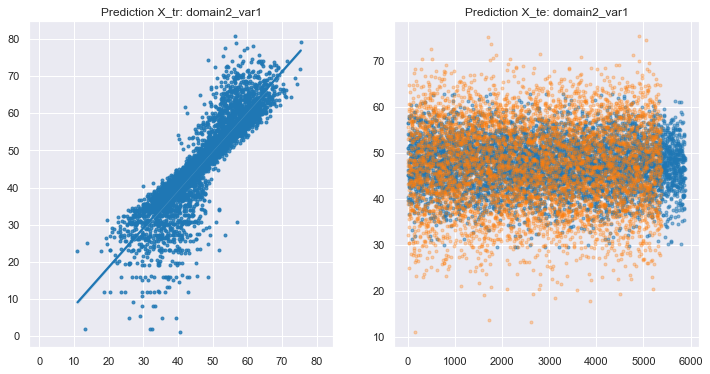

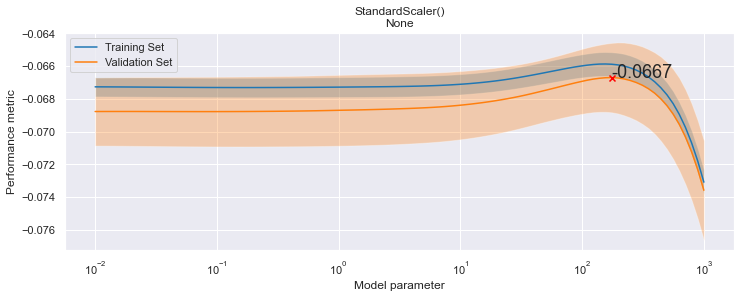

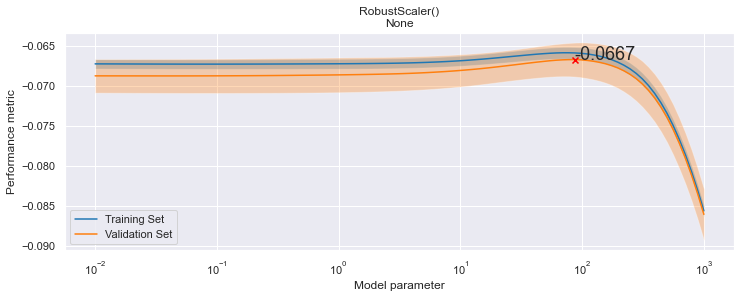

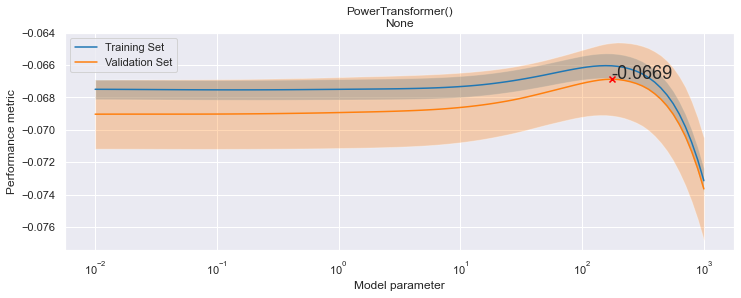

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
252,174.753,0.0001,None,StandardScaler(),-0.066703,0.002120,-0.065888,0.000734
249,155.568,0.0001,None,StandardScaler(),-0.066713,0.002081,-0.065873,0.000732
255,196.304,0.0001,None,StandardScaler(),-0.066725,0.002168,-0.065927,0.000739
235,86.9749,0.0001,None,RobustScaler(),-0.066744,0.002120,-0.065912,0.000737
246,138.489,0.0001,None,StandardScaler(),-0.066747,0.002048,-0.065879,0.000728
232,77.4264,0.0001,None,RobustScaler(),-0.066748,0.002079,-0.065892,0.000735
238,97.701,0.0001,None,RobustScaler(),-0.066773,0.002171,-0.065957,0.000743
229,68.9261,0.0001,None,RobustScaler(),-0.066776,0.002045,-0.065893,0.000730
258,220.513,0.0001,None,StandardScaler(),-0.066784,0.002221,-0.065997,0.000745
243,123.285,0.0001,None,StandardScaler(),-0.066797,0.002022,-0.065905,0.000720


Starting with target: domain2_var2
Size of dataset:  (5378, 102)
Fitting 5 folds for each of 300 candidates, totalling 1500 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  60 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 296 tasks      | elapsed:   14.0s
[Parallel(n_jobs=-1)]: Done 546 tasks      | elapsed:   26.5s
[Parallel(n_jobs=-1)]: Done 896 tasks      | elapsed:   44.1s
[Parallel(n_jobs=-1)]: Done 1346 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done 1500 out of 1500 | elapsed:  1.3min finished


Best: -0.065468 using {'estimator__alpha': 196.30406500402725, 'estimator__tol': 0.0001, 'pca': None, 'scaler': StandardScaler()}


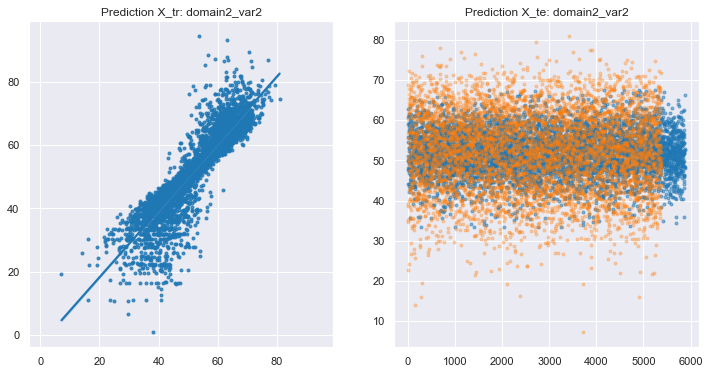

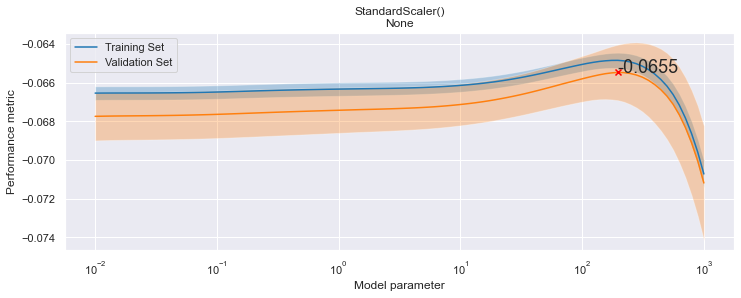

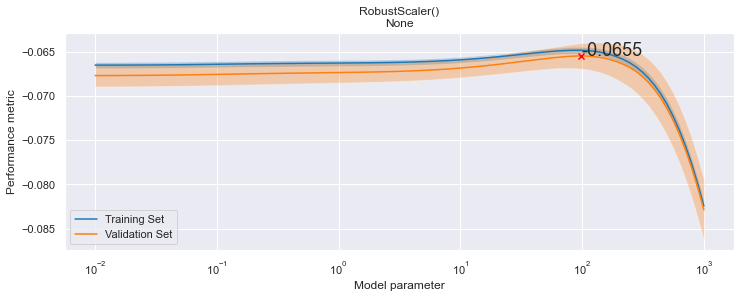

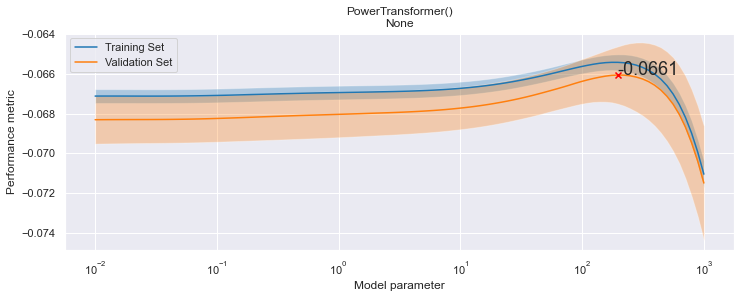

,param_estimator__alpha,param_estimator__tol,param_pca,param_scaler,mean_test_score,std_test_score,mean_train_score,std_train_score
255,196.304,0.0001,None,StandardScaler(),-0.065468,0.001436,-0.064843,0.000397
258,220.513,0.0001,None,StandardScaler(),-0.065477,0.001508,-0.064868,0.000408
252,174.753,0.0001,None,StandardScaler(),-0.065491,0.001375,-0.064845,0.000387
238,97.701,0.0001,None,RobustScaler(),-0.065496,0.001430,-0.064857,0.000390
241,109.75,0.0001,None,RobustScaler(),-0.065512,0.001503,-0.064889,0.000399
235,86.9749,0.0001,None,RobustScaler(),-0.065514,0.001366,-0.064855,0.000382
261,247.708,0.0001,None,StandardScaler(),-0.065521,0.001594,-0.064924,0.000422
249,155.568,0.0001,None,StandardScaler(),-0.065532,0.001318,-0.064865,0.000377
232,77.4264,0.0001,None,RobustScaler(),-0.065550,0.001309,-0.064871,0.000373
244,123.285,0.0001,None,RobustScaler(),-0.065566,0.001588,-0.064953,0.000410


,score,estimator__alpha,estimator__tol,pca,scaler
0,0.042310,0.091116,0.0001,None,StandardScaler()
1,0.053398,30.538555,0.0001,None,RobustScaler()
2,0.055883,220.513074,0.0001,None,StandardScaler()
3,0.066703,174.752840,0.0001,None,StandardScaler()
4,0.065468,196.304065,0.0001,None,StandardScaler()


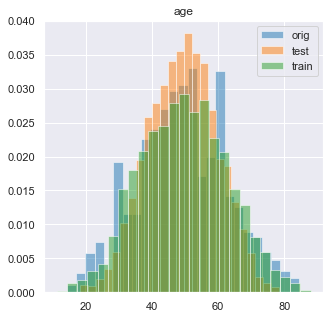

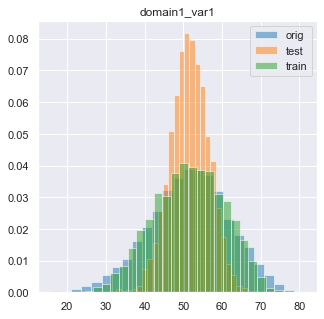

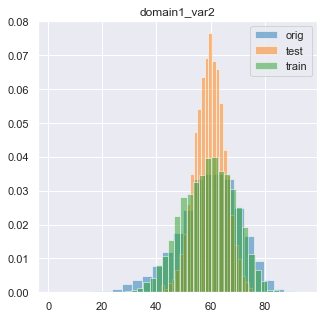

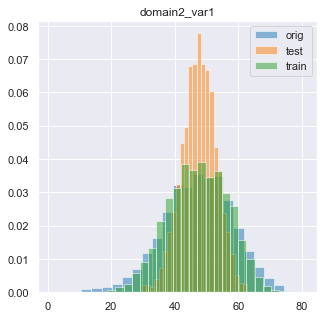

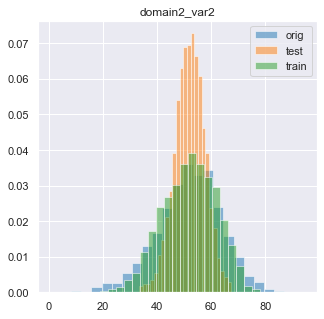

Score: 0.0549 | -0.0423 -0.0534 -0.0559 -0.0667 -0.0655


In [86]:
dataset_id = 'ridge'

predictions = {}
scores = []
grids = []

for tidx, target in enumerate(['age', 'domain1_var1', 'domain1_var2', 'domain2_var1', 'domain2_var2']):

    print('Starting with target: %s' % (target))
    estimator = Ridge()
    df_pred, pred_tr, pred_te, grid, idx = run_prediction(
        model_metric, target=target, estimator=estimator, tidx=tidx)

    display_grid_optimization_details(grid)

    predictions['%s_tr' % target] = pred_tr
    predictions['%s_te' % target] = pred_te
    predictions['%s_miss' % target] = idx

    scores.append(grid.best_score_)
    grids.append(grid)

# Display grids summary
grids_summary(grids)

# Compute overall score
weights = [.3, .175, .175, .175, .175]
score = np.sum([-s * weights[i] for i, s in enumerate(scores)])
score_postfix = [int(score*10000)] + [-int(s*10000) for i, s in enumerate(scores)]

df_results_tr, df_results_te = save_results(
    predictions, targets, train_id, test_id, sample_submission, dataset_id, score_postfix)

_, _, y_tr, _ = load_dataset()
df_target = pd.DataFrame(y_tr, columns=targets.columns)
plot_prediction_distributions(df_target, df_results_tr, df_results_te)

# Feedback of overall score
txt = 'Score: {:.4f} | {:.4f} {:.4f} {:.4f} {:.4f} {:.4f}'.format(score, *scores)
print(txt)